In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

plt.rcParams['figure.figsize'] = (12,8)
path = "c:/Windows/Fonts/malgun.ttf"
from matplotlib import font_manager, rc
font_name = font_manager.FontProperties(fname=path).get_name()
rc('font', family=font_name)
plt.rcParams['axes.unicode_minus'] = False

In [2]:
import geopandas as gpd
import folium

## 용인시 상권 정보

In [3]:
store = pd.read_csv('data/1.용인시_상권_정보.csv')
code = pd.read_csv('data/2.용인시_상권_업종코드.csv')

In [103]:
store.head(3)

,대분류코드,중분류코드,소분류코드,표준산업분류코드,표준산업분류명,행정동코드,행정동명,도로명주소,경도,위도,대분류명,중분류명,소분류명
0,Q,Q09,Q09A10,I56211,일반유흥 주점업,4146551000,풍덕천1동,경기도 용인시 수지구 풍덕천로139번길 6-5,127.096851,37.324611,음식,유흥주점,룸살롱/단란주점
1,Q,Q01,Q01A08,I56111,한식 음식점업,4146551000,풍덕천1동,경기도 용인시 수지구 풍덕천로190번길 23,127.102347,37.324553,음식,한식,족발/보쌈전문
2,Q,Q01,Q01A01,I56111,한식 음식점업,4146352000,구갈동,경기도 용인시 기흥구 갈곡로7번길 8,127.128573,37.272405,음식,한식,한식/백반/한정식


In [104]:
code.head(3)

,대분류코드,대분류명,중분류코드,중분류명,소분류코드,소분류명
0,Q,음식,Q05,닭/오리요리,Q05A01,삼계탕전문
1,Q,음식,Q05,닭/오리요리,Q05A02,닭갈비전문
2,Q,음식,Q01,한식,Q01A16,보리밥전문


In [6]:
store = pd.merge(store, code, 
                      how = 'left', left_on = ['대분류코드', '중분류코드', '소분류코드'], 
                      right_on = ['대분류코드', '중분류코드', '소분류코드'])
store.head()

,대분류코드,중분류코드,소분류코드,표준산업분류코드,표준산업분류명,행정동코드,행정동명,도로명주소,경도,위도,대분류명,중분류명,소분류명
0,Q,Q09,Q09A10,I56211,일반유흥 주점업,4146551000,풍덕천1동,경기도 용인시 수지구 풍덕천로139번길 6-5,127.096851,37.324611,음식,유흥주점,룸살롱/단란주점
1,Q,Q01,Q01A08,I56111,한식 음식점업,4146551000,풍덕천1동,경기도 용인시 수지구 풍덕천로190번길 23,127.102347,37.324553,음식,한식,족발/보쌈전문
2,Q,Q01,Q01A01,I56111,한식 음식점업,4146352000,구갈동,경기도 용인시 기흥구 갈곡로7번길 8,127.128573,37.272405,음식,한식,한식/백반/한정식
3,Q,Q09,Q09A10,I56211,일반유흥 주점업,4146151000,중앙동,경기도 용인시 처인구 금령로71번길 2,127.204204,37.235371,음식,유흥주점,룸살롱/단란주점
4,Q,Q10,Q10A01,I56111,한식 음식점업,4146359000,보정동,경기도 용인시 기흥구 죽전로 50,127.114245,37.320282,음식,별식/퓨전요리,죽전문점


<AxesSubplot:xlabel='count', ylabel='대분류명'>

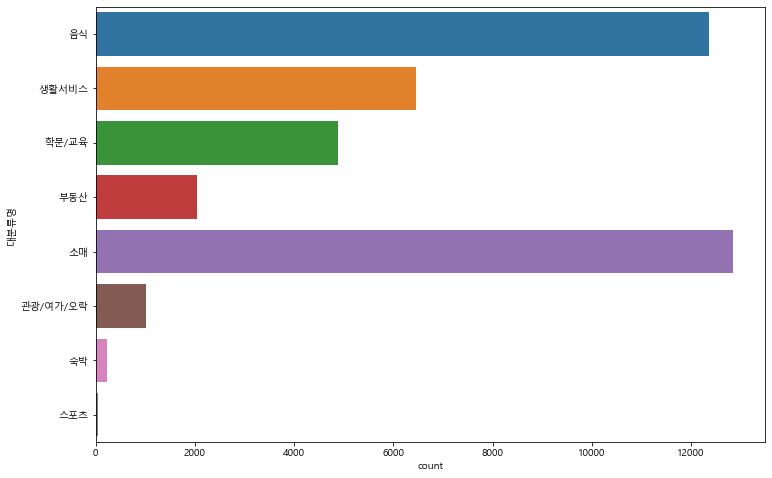

In [7]:
sns.countplot(y = '대분류명', data = store)

## 중분류 기준 상권 현황

In [20]:
store_counts = pd.DataFrame(
    store['중분류명'].value_counts())
store_pct = pd.DataFrame(
    store['중분류명'].value_counts(normalize = True))
store_df = store_counts.merge(store_pct, left_index = True, right_index = True)
store_df.columns = ['매장 수', '비율']

In [9]:
store_df[:20]

,매장 수,비율
한식,4376,0.109658
이/미용/건강,2935,0.073548
의복의류,2370,0.059390
종합소매점,2259,0.056608
부동산중개,1750,0.043853
커피점/카페,1739,0.043577
유흥주점,1233,0.030898
음/식료품소매,1172,0.029369
가정/주방/인테리어,1168,0.029269
학원-보습교습입시,1145,0.028692


## 거주인구 정보

In [10]:
total_pop_grid = gpd.read_file('data/3.용인시_인구정보(총인구수)_격자.geojson')
total_pop_grid.head()

,gid,val,geometry
0,다바661999,NaN,"MULTIPOLYGON (((127.11851 37.09713, 127.11851 ..."
1,다바662996,NaN,"MULTIPOLYGON (((127.11965 37.09443, 127.11965 ..."
2,다바662997,NaN,"MULTIPOLYGON (((127.11965 37.09533, 127.11964 ..."
3,다바662998,NaN,"MULTIPOLYGON (((127.11964 37.09623, 127.11964 ..."
4,다바662999,NaN,"MULTIPOLYGON (((127.11964 37.09713, 127.11963 ..."


In [11]:
# Nan -> 거주인구 0
total_pop_grid["val"] = total_pop_grid["val"].fillna(0)
# 거주인구가 있는 곳만 추출
total_pop_grid_Y = total_pop_grid[total_pop_grid["val"] > 0]

### 지도에 행정 구역 추가

In [14]:
dong = gpd.read_file('data/13.용인시_행정경계(읍면동).geojson')
dong.head()

,BASE_DATE,ADM_DR_CD,ADM_DR_NM,geometry
0,20190630,3119111,포곡읍,"MULTIPOLYGON (((127.20460 37.32541, 127.20518 ..."
1,20190630,3119112,모현읍,"MULTIPOLYGON (((127.23872 37.35927, 127.23869 ..."
2,20190630,3119132,남사면,"MULTIPOLYGON (((127.17906 37.18561, 127.17996 ..."
3,20190630,3119113,이동읍,"MULTIPOLYGON (((127.15698 37.22781, 127.15766 ..."
4,20190630,3119134,원삼면,"MULTIPOLYGON (((127.33855 37.18016, 127.33850 ..."


In [99]:
m = folium.Map([37.2410448, 127.1757375], tiles='cartodbpositron', 
               zoom_start=12) # 용인시청

m.choropleth(
    geo_data=total_pop_grid_Y,
    name='Choropleth',
    data=total_pop_grid_Y,
    columns=['gid','val'],
    key_on="feature.properties.gid",
    fill_color='YlOrRd',
    fill_opacity=1,
    line_opacity=0.8,
)

# 동별 경계 추가
style_function = lambda x: {'opacity': 1,'fillOpacity':0,'color':'green'}
folium.GeoJson(dong, style_function=style_function,
               highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.5, 
                                'weight': 0.1},
               tooltip = folium.features.GeoJsonTooltip(
                   fields = ['ADM_DR_NM'],
                   aliases = [''],
                   style = ("background-color: white; color: #333333; font-family: arial; font-size: 10px; padding: 10px;"))).add_to(m)

m.add_child(tooltip)
m.keep_in_front(tooltip)
folium.LayerControl().add_to(m)

m

D:\Anaconda\envs\compas\lib\site-packages\folium\folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [16]:
store.head()

,대분류코드,중분류코드,소분류코드,표준산업분류코드,표준산업분류명,행정동코드,행정동명,도로명주소,경도,위도,대분류명,중분류명,소분류명
0,Q,Q09,Q09A10,I56211,일반유흥 주점업,4146551000,풍덕천1동,경기도 용인시 수지구 풍덕천로139번길 6-5,127.096851,37.324611,음식,유흥주점,룸살롱/단란주점
1,Q,Q01,Q01A08,I56111,한식 음식점업,4146551000,풍덕천1동,경기도 용인시 수지구 풍덕천로190번길 23,127.102347,37.324553,음식,한식,족발/보쌈전문
2,Q,Q01,Q01A01,I56111,한식 음식점업,4146352000,구갈동,경기도 용인시 기흥구 갈곡로7번길 8,127.128573,37.272405,음식,한식,한식/백반/한정식
3,Q,Q09,Q09A10,I56211,일반유흥 주점업,4146151000,중앙동,경기도 용인시 처인구 금령로71번길 2,127.204204,37.235371,음식,유흥주점,룸살롱/단란주점
4,Q,Q10,Q10A01,I56111,한식 음식점업,4146359000,보정동,경기도 용인시 기흥구 죽전로 50,127.114245,37.320282,음식,별식/퓨전요리,죽전문점


### 한식 음식점 분포도

In [68]:
kfood = store[store['중분류명'] == '한식']
kfood_count = kfood['행정동명'].value_counts()
kfood_count.head()

구갈동      271
풍덕천1동    261
중앙동      251
포곡읍      246
보정동      212
Name: 행정동명, dtype: int64

In [19]:
m = folium.Map([37.2410448 ,127.1757375],zoom_start=12) # 용인시청

m.choropleth(
    geo_data=dong,
    data=kfood_count,
    columns=[kfood_count.index, kfood_count],
    key_on="feature.properties.ADM_DR_NM",
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
)
m

D:\Anaconda\envs\compas\lib\site-packages\folium\folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [21]:
### 행정구역(polygon) 중심 좌표 구하기
from shapely import wkt
dong['center_x'] = dong['geometry'].apply(lambda x: wkt.loads(str(x)).centroid.x)
dong['center_y'] = dong['geometry'].apply(lambda x: wkt.loads(str(x)).centroid.y)

dong_df = dong[['ADM_DR_NM', 'center_x', 'center_y']]

In [46]:
kfood_count = kfood_count.reset_index()
kfood_count.columns = ['ADM_DR_NM', 'Count']

In [64]:
# 행정구역 별 중심 좌표, 식당 개수 df merge
dong_df = pd.merge(dong_df, kfood_count, 
                   how = 'left', left_on = ['ADM_DR_NM'], 
                   right_on = ['ADM_DR_NM'])
dong_df.set_index('ADM_DR_NM', inplace = True)

In [65]:
dong_df.head()

,center_x,center_y,Count
ADM_DR_NM,,,
포곡읍,127.217566,37.290493,246
모현읍,127.218163,37.326430,5
남사면,127.156657,37.132655,89
이동읍,127.211161,37.164714,6
원삼면,127.313338,37.163241,57


In [67]:
m = folium.Map([37.2410448, 127.1757375], tiles='cartodbpositron', 
               zoom_start=12) # 용인시청

# 거주인구
m.choropleth(
    geo_data=total_pop_grid_Y,
    name='Choropleth',
    data=total_pop_grid_Y,
    columns=['gid','val'],
    key_on="feature.properties.gid",
    fill_color='YlOrRd',
    fill_opacity=1,
    line_opacity=0.8,
)

# 동별 경계 추가
style_function = lambda x: {'opacity': 1,'fillOpacity':0,'color':'green'}
folium.GeoJson(dong, style_function=style_function,
               highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.5, 
                                'weight': 0.1},
               tooltip = folium.features.GeoJsonTooltip(
                   fields = ['ADM_DR_NM'],
                   aliases = [''],
                   style = ("background-color: white; color: #333333; font-family: arial; font-size: 10px; padding: 10px;"))).add_to(m)

m.add_child(tooltip)
m.keep_in_front(tooltip)
folium.LayerControl().add_to(m)

# 동 별 식당 개수를 원의 크기로 시각화
for n in dong_df.index:
    folium.CircleMarker([dong_df['center_y'][n], dong_df['center_x'][n]],
                        radius = dong_df['Count'][n] * 0.15,
                        color='#3186cc', fill_color='#3186cc').add_to(m)
m